In [20]:
#import packages
import numpy as np
import pandas as pd
import datetime as dt
import os 

b'\r\n<!doctype html>\r\n<html lang="fr">\r\n<head>\r\n\t<!-- Required meta tags -->\r\n\t<meta charset="utf-8">\r\n\t<meta name="viewport" content="width=device-width, initial-scale=1, shrink-to-fit=no">\r\n\t\r\n\t<!-- Bootstrap CSS -->\r\n\t<link href="https://cdn.jsdelivr.net/npm/bootstrap@5.3.2/dist/css/bootstrap.min.css" rel="stylesheet" integrity="sha384-T3c6CoIi6uLrA9TneNEoa7RxnatzjcDSCmG1MXxSR1GAsXEV/Dwwykc2MPK8M2HN" crossorigin="anonymous">\r\n\t<link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/bootstrap-icons@1.11.3/font/bootstrap-icons.min.css">\r\n\t\r\n\t<title>Annuaire LDAP BGE Hauts de France</title>\r\n\t\r\n\t<style>\r\n\t\t /* unvisited link */\r\n\t\t.itemMenu a:link {\r\n\t\t\tcolor: white;\r\n\t\t}\r\n\r\n\t\t/* visited link */\r\n\t\t.itemMenu a:visited {\r\n\t\t\tcolor: white;\r\n\t\t\tbackground-color: green;\r\n\t\t}\r\n\r\n\t\t/* mouse over link */\r\n\t\t.itemMenu a:hover {\r\n\t\t\tcolor: black;\r\n\t\t\tbackground-color: lightgreen;\r\n\t\t}\r\n\r\
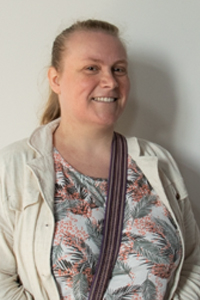
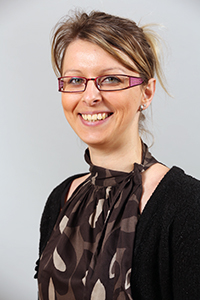
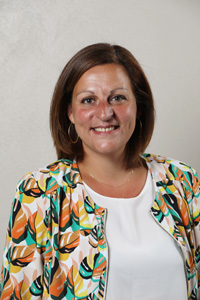
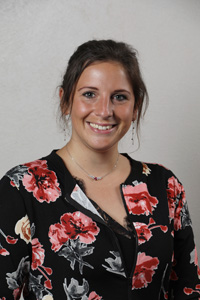
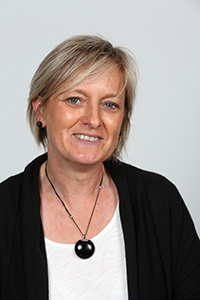
...
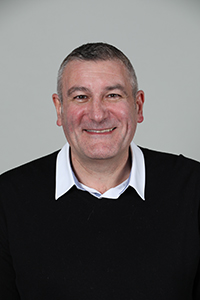
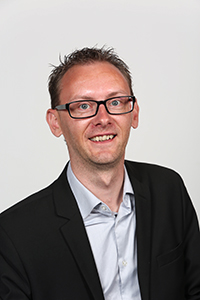
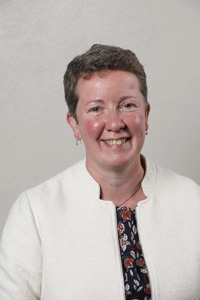
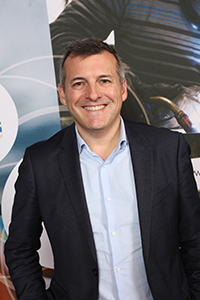
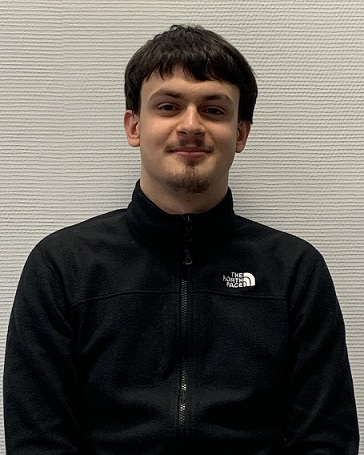

In [29]:
#import page
import requests as rq
base_url = 'https://minimisj2.bge-hautsdefrance.fr/contactsLDAP_photo_modal.php'
id= '43017140066119446'
page = rq.get(f"{base_url}?id={id}", auth=('asibille', 'Electro22@AppliRH'))
list = page.content
list


<!DOCTYPE html>

<html lang="fr">
<head>
<!-- Required meta tags -->
<meta charset="utf-8"/>
<meta content="width=device-width, initial-scale=1, shrink-to-fit=no" name="viewport"/>
<!-- Bootstrap CSS -->
<link crossorigin="anonymous" href="https://cdn.jsdelivr.net/npm/bootstrap@5.3.2/dist/css/bootstrap.min.css" integrity="sha384-T3c6CoIi6uLrA9TneNEoa7RxnatzjcDSCmG1MXxSR1GAsXEV/Dwwykc2MPK8M2HN" rel="stylesheet"/>
<link href="https://cdn.jsdelivr.net/npm/bootstrap-icons@1.11.3/font/bootstrap-icons.min.css" rel="stylesheet"/>
<title>Annuaire LDAP BGE Hauts de France</title>
<style>
		 /* unvisited link */
		.itemMenu a:link {
			color: white;
		}

		/* visited link */
		.itemMenu a:visited {
			color: white;
			background-color: green;
		}

		/* mouse over link */
		.itemMenu a:hover {
			color: black;
			background-color: lightgreen;
		}

		/* selected link */
		.itemMenu a:active {
			color: yellow;
			background-color: green;
		}
		
		/* bouton de retour en haut de page */
		.backtoto
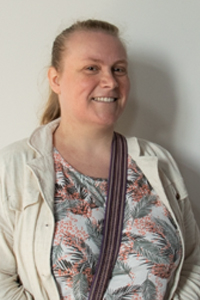
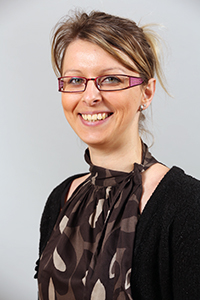
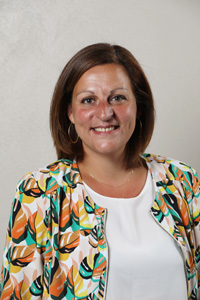
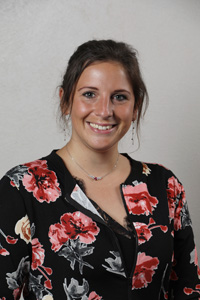
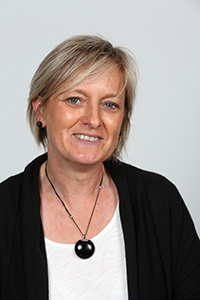
...
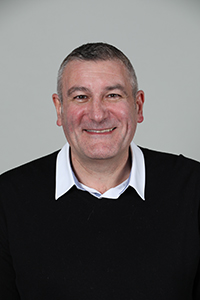
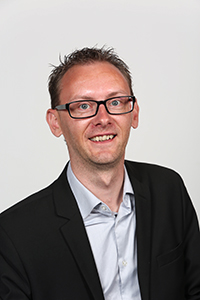
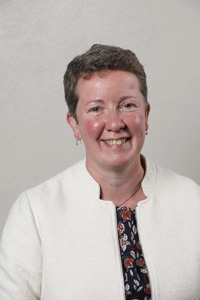
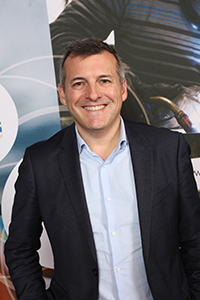
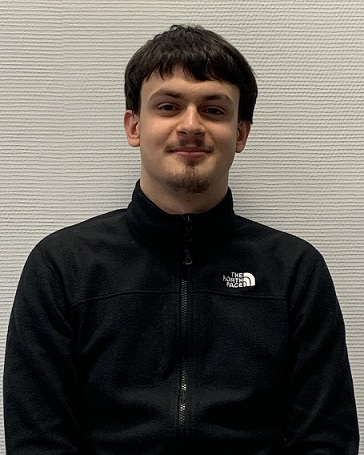

In [30]:
#Beautifulsoup
from bs4 import BeautifulSoup
list_bs = BeautifulSoup(list, 'html.parser')
list_bs

In [31]:
list_name = list_bs.find_all('h1')
list_name = [name.get_text() for name in list_name]
list_name
len(list_name)

143

In [32]:
list_position = list_bs.find_all('h2')
list_position = [position.get_text() for position in list_position]
list_position
len(list_position)

143

In [33]:
list_agency = list_bs.find_all('h3')
list_agency = [agency.get_text() for key, agency in enumerate(list_agency) if key % 2 == 0]
list_agency

['Lambersart',
 "Villeneuve d'Ascq",
 'Siège',
 'Roubaix',
 'Béthune',
 'Lens',
 'Siège',
 'Valenciennes',
 'Sin le Noble',
 'Arras',
 'Siège + Arras',
 'Saint-Omer',
 "Siège + Villeneuve d'Ascq",
 'Siège',
 'Maubeuge',
 'Béthune',
 'Arras',
 'Lambersart',
 'Arras',
 'Béthune',
 'Tourcoing + Roubaix',
 'Denain',
 'Arras',
 'Lambersart',
 "Villeneuve d'Ascq",
 "Villeneuve d'Ascq",
 'Roubaix',
 'Maubeuge',
 'Tourcoing',
 'Béthune + Saint-Omer',
 'Lambersart + Hazebrouck',
 "Villeneuve d'Ascq",
 'Maubeuge',
 'Lambersart',
 'Sin le Noble',
 'Cambrai',
 'Béthune',
 'Sin le Noble',
 'Maubeuge',
 'Lens',
 'Tourcoing',
 'Hazebrouck',
 'Roubaix',
 'Tourcoing',
 'Denain',
 'Sin le Noble + Cambrai',
 'Saint-Omer',
 "Villeneuve d'Ascq",
 'Arras',
 'Denain',
 'Béthune',
 'Arras',
 'Sin le Noble',
 'Tourcoing',
 'Lens',
 'Lens',
 'Denain',
 'Lambersart',
 'Saint-Omer',
 'Sin le Noble',
 'Denain',
 "Villeneuve d'Ascq",
 'Lambersart',
 'Sin le Noble',
 'Roubaix',
 'Cambrai',
 'Hazebrouck',
 'Arras',
 

In [34]:
type(list_agency)
len(list_agency)

143

In [35]:
try:
    list(zip(list_name, list_position, list_agency))

except Exception as ex:
    print(f"An unexpected exception occurred: {ex}")
    # Handle other exceptions

An unexpected exception occurred: 'bytes' object is not callable


In [40]:
global_list = {'name' : list_name,
               'position' : list_position,
               'agency' : list_agency}
global_list = pd.DataFrame(global_list)
global_list

,name,position,agency
0,Albane PAVOT,Secrétaire,Lambersart
1,Amandine COMPIEGNE,Assistante de territoire,Villeneuve d'Ascq
2,Aurélie VANHILLE,Responsable Administratif et Financier,Siège
3,Florence HOEZEELE,Assistante de territoire,Roubaix
4,Isabelle PLICHARD,Assistante de territoire,Béthune
...,...,...,...
138,Claudine PERUS,Employée d'entretien,Valenciennes
139,Grégory SAGEZ,Directeur Général,Siège
140,Mattéo DOLCI,Service civique,Lens
141,Niels GUILBAUD,Service civique,Siège


In [ ]:
global_list.to_csv('people_global_list.csv', index=False)

SELENIUM

In [37]:
import selenium 
from selenium import webdriver
from selenium.webdriver.chrome.service import Service
from selenium.webdriver.chrome.options import Options

#import packages dynamic scraping
from selenium.webdriver.common.by import By
from selenium.webdriver.common.keys import Keys


In [38]:
#dynamic website
from selenium.webdriver.support.ui import WebDriverWait
from selenium.webdriver.support import expected_conditions as EC
from selenium.common.exceptions import TimeoutException, WebDriverException, NoSuchElementException


In [39]:
try:
    service = Service()
    options = webdriver.ChromeOptions
    driver = webdriver.Chrome(service=service, options=option)
except Exception as ex:
    print(f"An unexpected exception occurred: {ex}")
    # Handle other exceptions

finally:
    if 'driver' in locals() and driver is not None:
        driver.quit()

An unexpected exception occurred: name 'option' is not defined
